# Train cellpose on watershed segmentations

In [1]:

import skimage

import matplotlib.pyplot as plt

import sys

sys.path += [".."]  # NOTE find shared modules
from util.preprocess import *
from util.plot import *

import colorcet
import itertools as it
from scipy.ndimage import generic_filter

from cellpose import models
from cellpose.io import imread


def norm(x):
    return (x - x.min()) / (x.max() - x.min())

<Axes: title={'center': 'Input image (green channel): third/1.jpg'}>

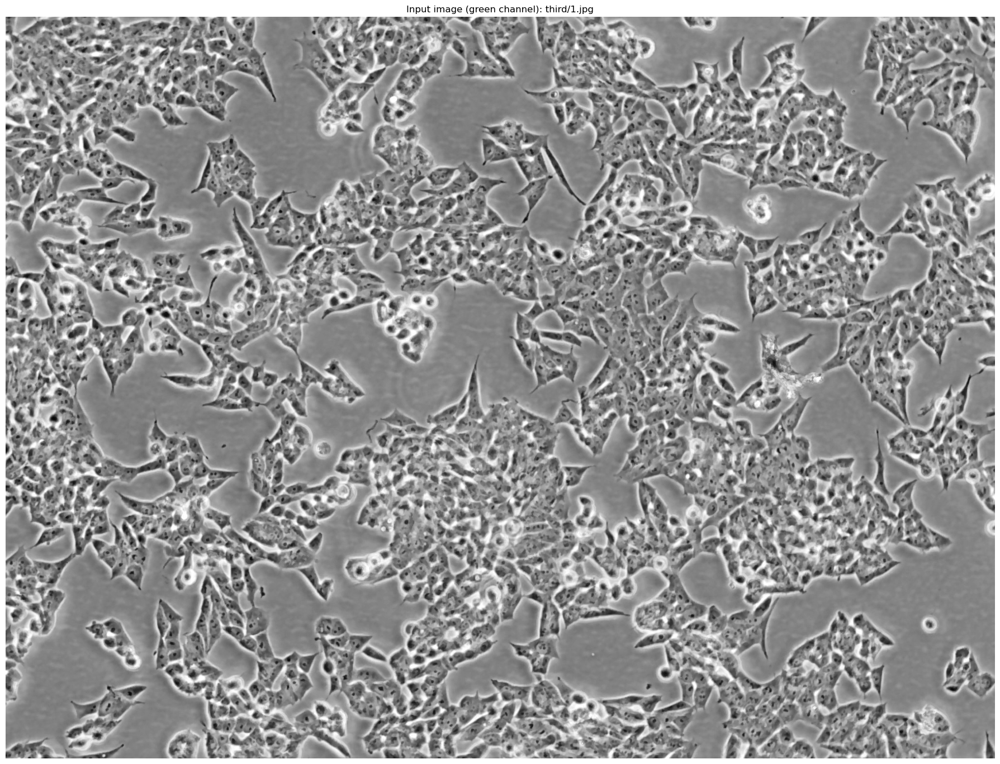

In [2]:

img_path = "third/1.jpg"
img = imread(f"../data/{img_path}")
img = img.astype(np.float32) / 255

# green channel turned out to be the sharpest
G = img[:, :, 1]

pos = preprocess_point("../data/third/annotations.json")
neg = preprocess_point("../data/third/annot-bg.json")


plot_image(G, title=f"Input image (green channel): {img_path}")

# # %%
# import cv2

# yuv = cv2.cvtColor(img, cv2.COLOR_BGR2YUV)

# plot_image(yuv[:,:,0], title=f'Input image (Y channel): {img_path}');
# plot_image(yuv[:,:,1], title=f'Input image (U channel): {img_path}');

/gpfs/space/home/eckhardt/.micromamba/envs/cellpose/lib/python3.11/site-packages/onnxruntime/capi/onnxruntime_inference_collection.py:69: UserWarning: Specified provider 'CUDAExecutionProvider' is not in available provider names.Available providers: 'AzureExecutionProvider, CPUExecutionProvider'
  warnings.warn(
2023-11-23 17:33:00.372144868 [E:onnxruntime:Default, env.cc:254 ThreadMain] pthread_setaffinity_np failed for thread: 44144, index: 5, mask: {6, 38, }, error code: 22 error msg: Invalid argument. Specify the number of threads explicitly so the affinity is not set.
2023-11-23 17:33:00.372196744 [E:onnxruntime:Default, env.cc:254 ThreadMain] pthread_setaffinity_np failed for thread: 44145, index: 6, mask: {7, 39, }, error code: 22 error msg: Invalid argument. Specify the number of threads explicitly so the affinity is not set.
2023-11-23 17:33:00.372109888 [E:onnxruntime:Default, env.cc:254 ThreadMain] pthread_setaffinity_np failed for thread: 44142, index: 3, mask: {4, 36, }, e

<Axes: title={'center': 'Mask (fake phase reconstruction, threshold 0.01)'}>

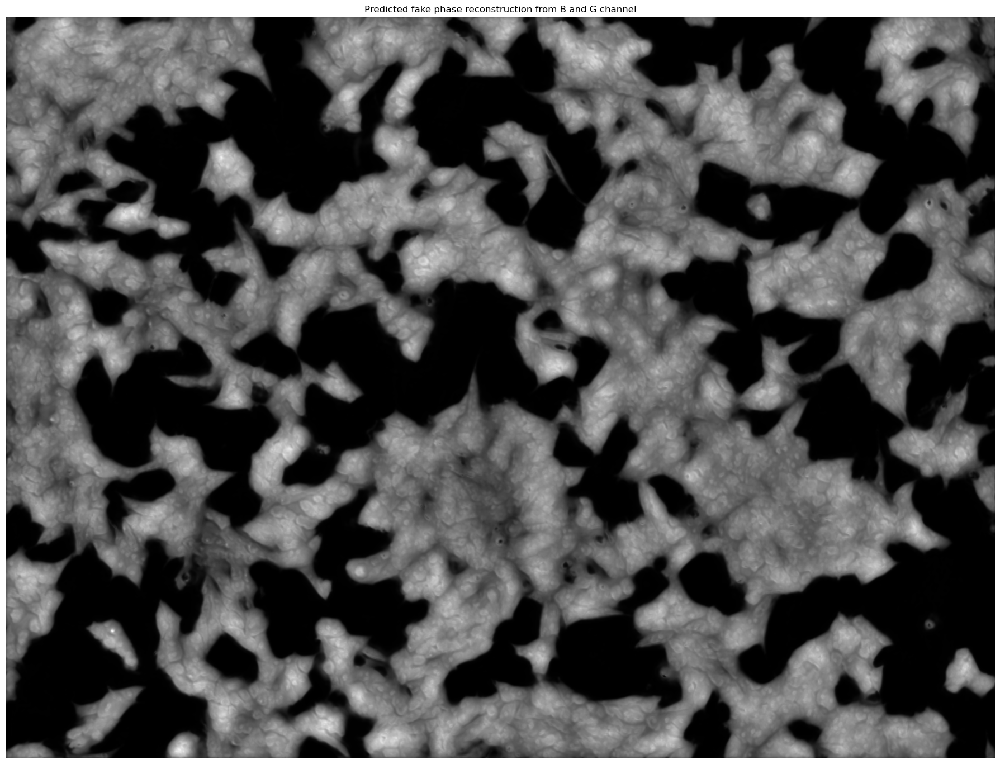

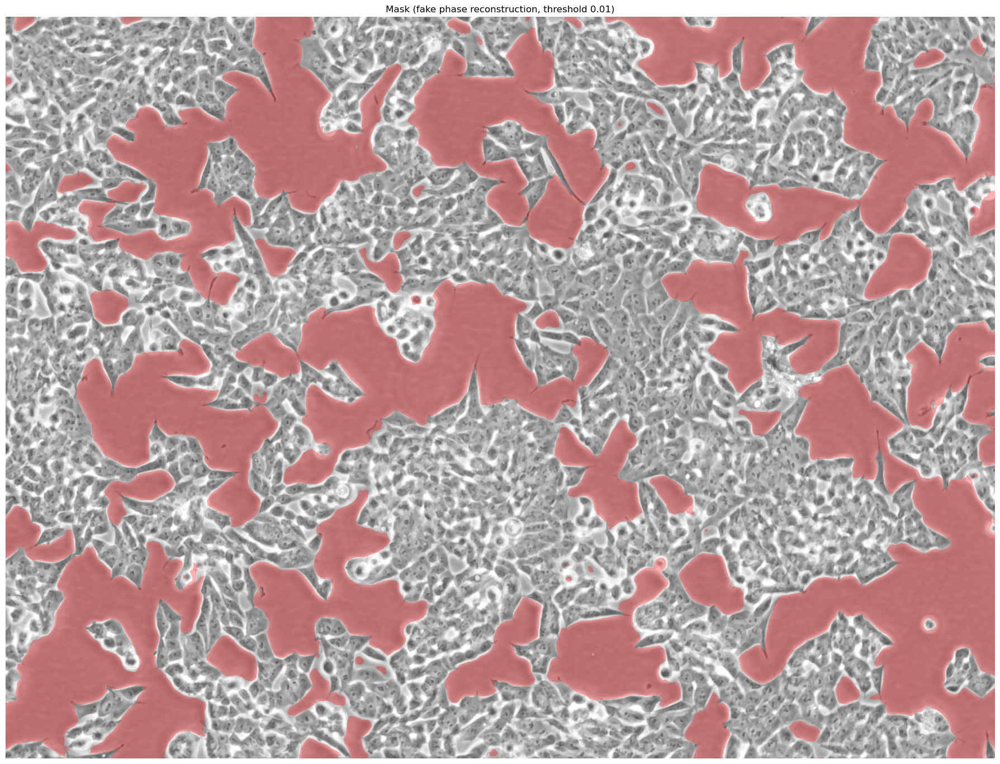

In [3]:

import onnxruntime as ort
import numpy as np


def get_sess(model_path: str):
    providers = [
        (
            "CUDAExecutionProvider",
            {
                "device_id": 0,
                "gpu_mem_limit": int(
                    8000 * 1024 * 1024
                ),  # parameter demands value in bytes
                "arena_extend_strategy": "kSameAsRequested",
                "cudnn_conv_algo_search": "HEURISTIC",
                "do_copy_in_default_stream": True,
            },
        ),
        "CPUExecutionProvider",
    ]
    sess_opts: ort.SessionOptions = ort.SessionOptions()
    sess_opts.log_severity_level = 2
    sess_opts.log_verbosity_level = 2
    sess = ort.InferenceSession(model_path, providers=providers, sess_options=sess_opts)
    return sess


model_path = "../data/phaseimaging-combo-v3.onnx"

input = np.expand_dims(np.transpose(img[..., [2, 1]], (2, 0, 1)), axis=0)

sess = get_sess(model_path=model_path)
output_names = [out.name for out in sess.get_outputs()]
input_name = sess.get_inputs()[0].name

pred = sess.run(output_names, {input_name: input})[0]

thresh = 0.01
mask = (pred[0, 0] > thresh).reshape(img.shape[:2])

plot_image(
    pred[0, 0], title=f"Predicted fake phase reconstruction from B and G channel"
)
plot_image(
    skimage.color.label2rgb(1 - mask, img, bg_color=None, alpha=0.3),
    title=f"Mask (fake phase reconstruction, threshold {thresh:.2f})",
)

# # %%

# variance_square = lambda x: np.sqrt(np.sum((x - (M:=np.mean(x)))**2) / (x.size - 1)) / M

# var = generic_filter(img/255, variance_square, size=12)


# thresh = 0.05
# mask = (var>thresh).reshape(img.shape)


# plot_image(var, title=f'Variance');
# plot_image(mask, title=f'Thresholded Variance {thresh:.2f}');
# plot_image(skimage.color.label2rgb(1-mask, img, bg_color=None, alpha=0.3), title=f'Masked Input Image');

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


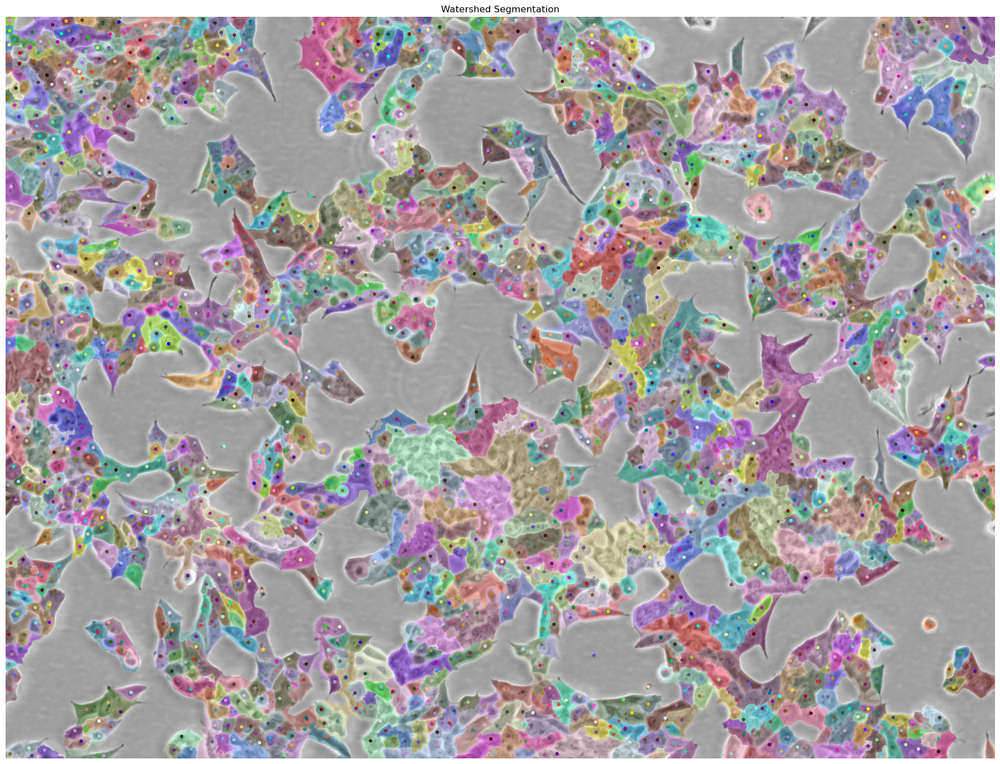

In [4]:

mark = np.zeros(img.shape[:2], dtype=int)
mark[pos[:, 0], pos[:, 1]] = np.arange(len(pos)) + 1
# mark[neg[:,0], neg[:,1]] = -1

ws = skimage.segmentation.watershed(norm(G), mask=mask, markers=mark)
ws[ws == 1] = 0

plot = skimage.color.label2rgb(ws, G, bg_color=None, alpha=0.4, colors=colors)
# plot = skimage.segmentation.mark_boundaries(plot, ws, color=colors)
ax = plot_image(plot, title="Watershed Segmentation")
ax.scatter(pos[:, 1], pos[:, 0], c=list(mk_colors(pos)), marker="o", s=12)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


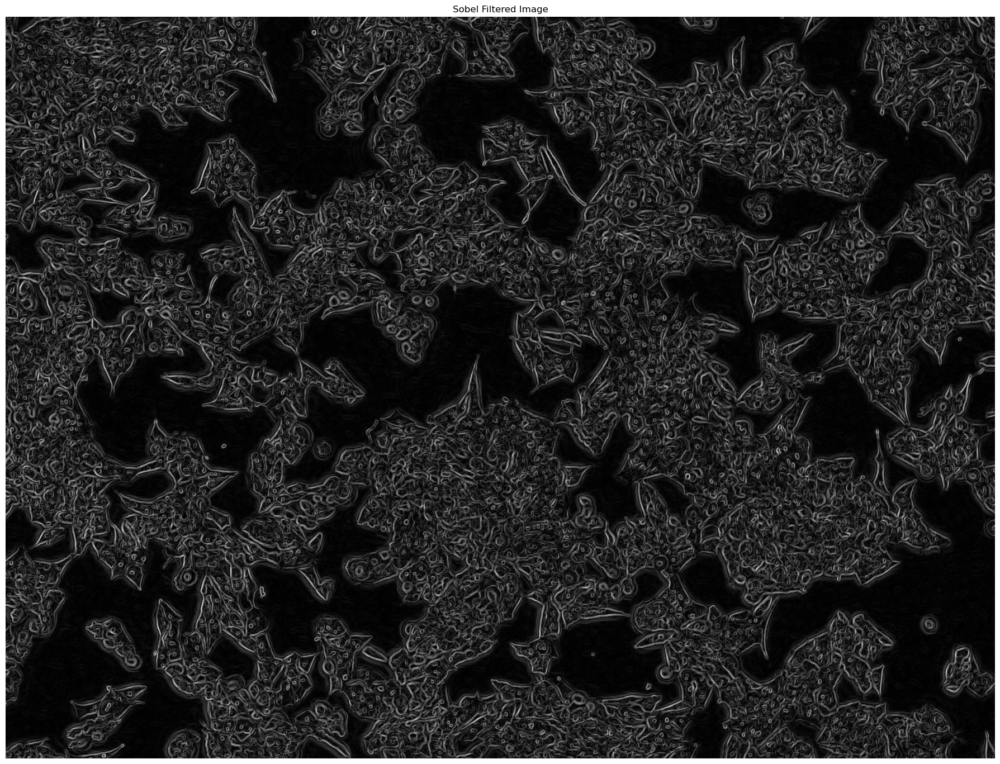

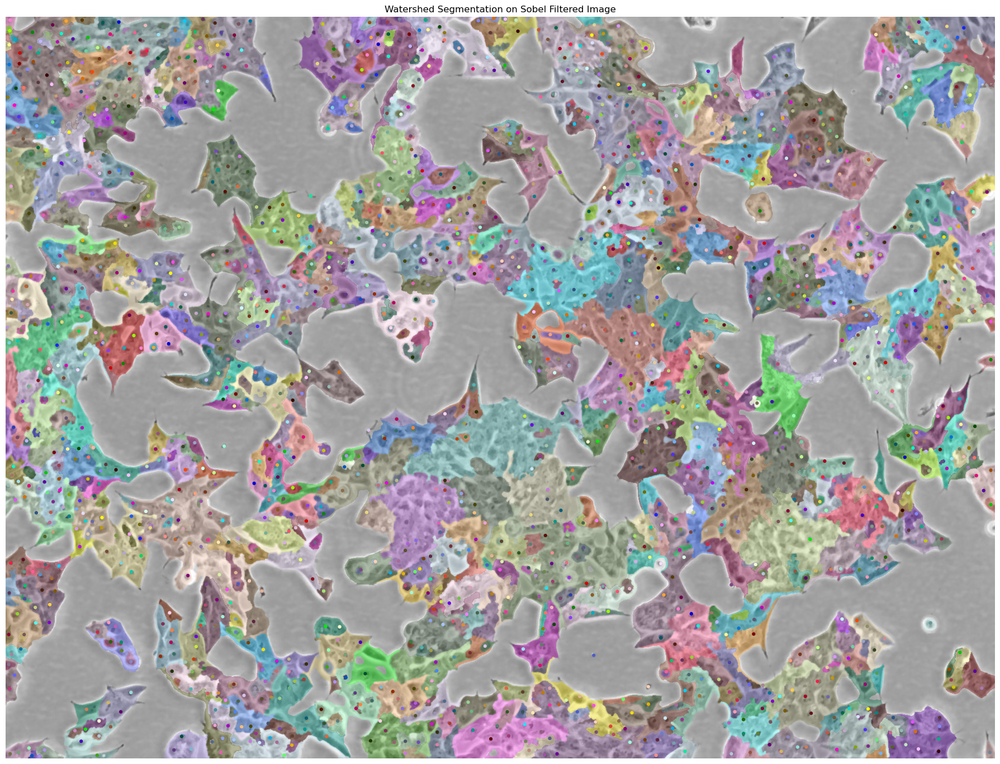

In [5]:

sobel = norm(skimage.filters.sobel(norm(G)))

ws_sobel = skimage.segmentation.watershed(sobel, mask=mask, markers=mark)

plot_image(sobel, title="Sobel Filtered Image")

plot = skimage.color.label2rgb(ws_sobel, G, bg_color=None, alpha=0.4, colors=colors)
# plot = skimage.segmentation.mark_boundaries(plot, ws_sobel, color=colors)
ax = plot_image(plot, title="Watershed Segmentation on Sobel Filtered Image")
ax.scatter(pos[:, 1], pos[:, 0], c=list(mk_colors(pos)), marker="o", s=12)

/gpfs/space/home/eckhardt/.micromamba/envs/cellpose/lib/python3.11/site-packages/cellpose/plot.py:39: RuntimeWarning: overflow encountered in square
  mag = np.clip(transforms.normalize99(np.sqrt(np.sum(dP**2,axis=0))), 0, 1.)
/gpfs/space/home/eckhardt/.micromamba/envs/cellpose/lib/python3.11/site-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: overflow encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/gpfs/space/home/eckhardt/.micromamba/envs/cellpose/lib/python3.11/site-packages/numpy/lib/function_base.py:4655: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)


/gpfs/space/home/eckhardt/.micromamba/envs/cellpose/lib/python3.11/site-packages/cellpose/plot.py:54: RuntimeWarning: invalid value encountered in cast
  im = (np.clip(im, 0, 1) * 255).astype(np.uint8)


<Axes: title={'center': 'cellpose (vanilla): third/1.jpg, diameter 18px'}>

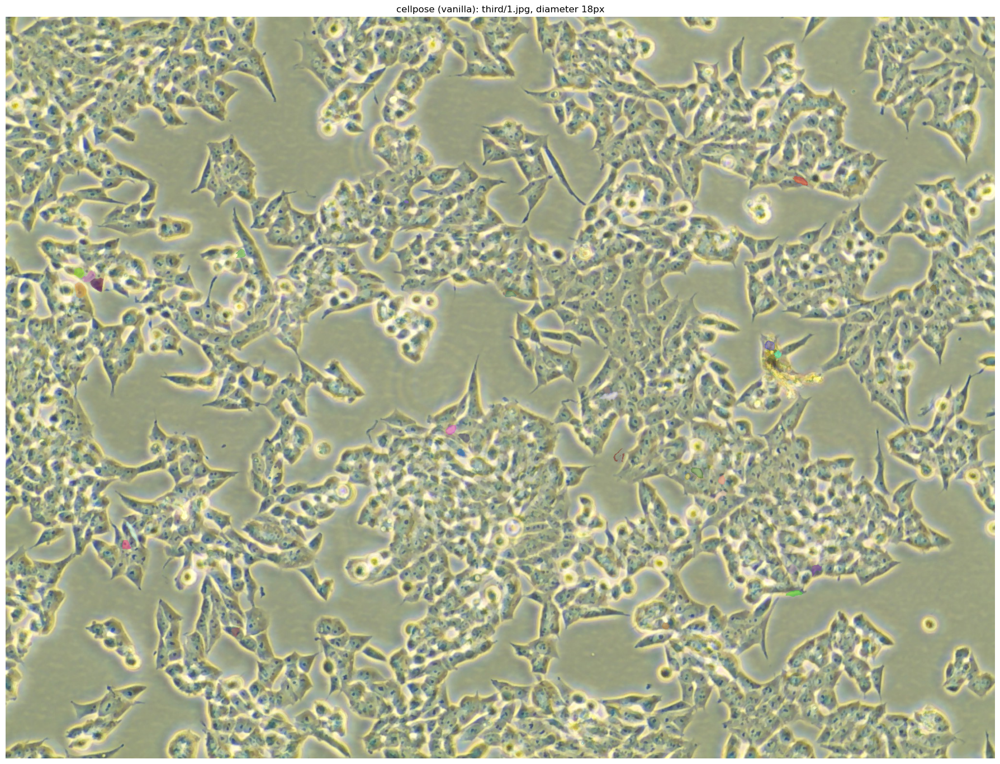

In [6]:

model = models.Cellpose(model_type="cyto", gpu=True, net_avg=True)

images = [img]

masks, _flows, _styles, diams = model.eval(
    images, diameter=None, channels=[[2, 0]]
)  # automatic diameter detection works often well

plot_image(
    skimage.color.label2rgb(
        masks[0], img, bg_color=None, alpha=0.4, colors=colors, saturation=1
    ),
    title=f"cellpose (vanilla): {img_path}, diameter {diams[0]:.0f}px",
)

  0%|          | 0/1 [00:00<?, ?it/s]

100%|██████████| 1/1 [00:14<00:00, 14.14s/it]

100%|██████████| 1/1 [00:14<00:00, 14.14s/it]

/gpfs/space/home/eckhardt/.micromamba/envs/cellpose/lib/python3.11/site-packages/cellpose/transforms.py:352: UserWarning: chan to seg' has value range of ZERO
  warnings.warn("chan to seg' has value range of ZERO")


/gpfs/space/home/eckhardt/.micromamba/envs/cellpose/lib/python3.11/site-packages/cellpose/plot.py:39: RuntimeWarning: overflow encountered in square
  mag = np.clip(transforms.normalize99(np.sqrt(np.sum(dP**2,axis=0))), 0, 1.)
/gpfs/space/home/eckhardt/.micromamba/envs/cellpose/lib/python3.11/site-packages/numpy/core/fromnumeric.py:88: RuntimeWarning: overflow encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
/gpfs/space/home/eckhardt/.micromamba/envs/cellpose/lib/python3.11/site-packages/numpy/lib/function_base.py:4655: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)
/gpfs/space/home/eckhardt/.micromamba/envs/cellpose/lib/python3.11/site-packages/cellpose/plot.py:54: RuntimeWarning: invalid value encountered in cast
  im = (np.clip(im, 0, 1) * 255).astype(np.uint8)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


<Axes: title={'center': 'cellpose (trained on watershed): third/1.jpg'}>

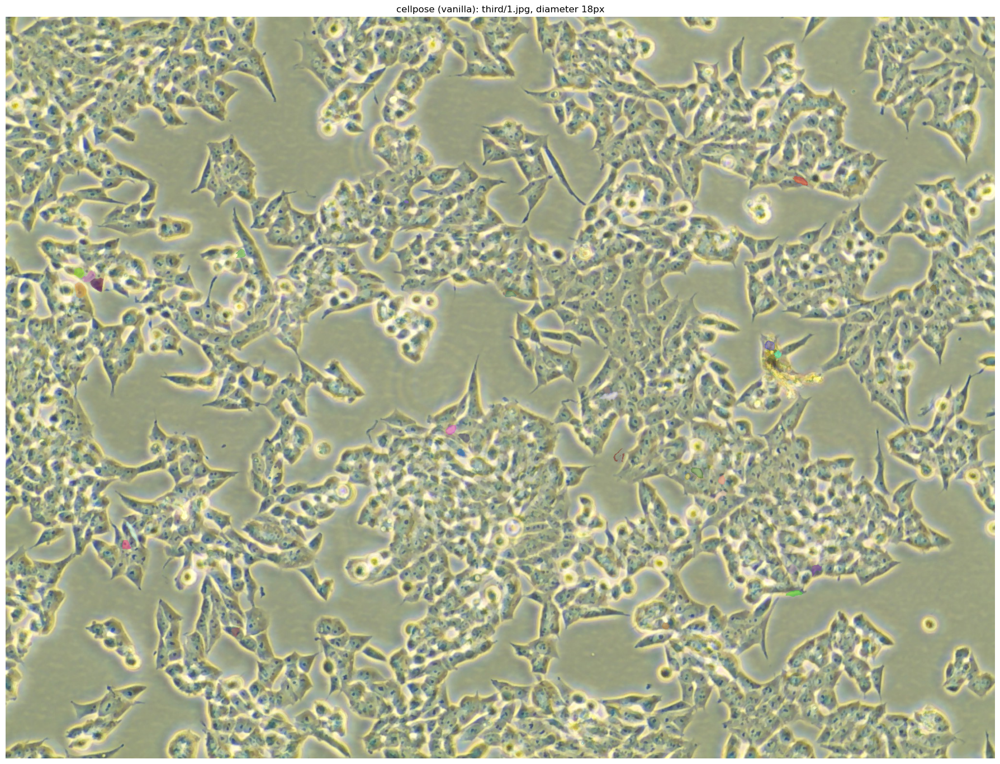

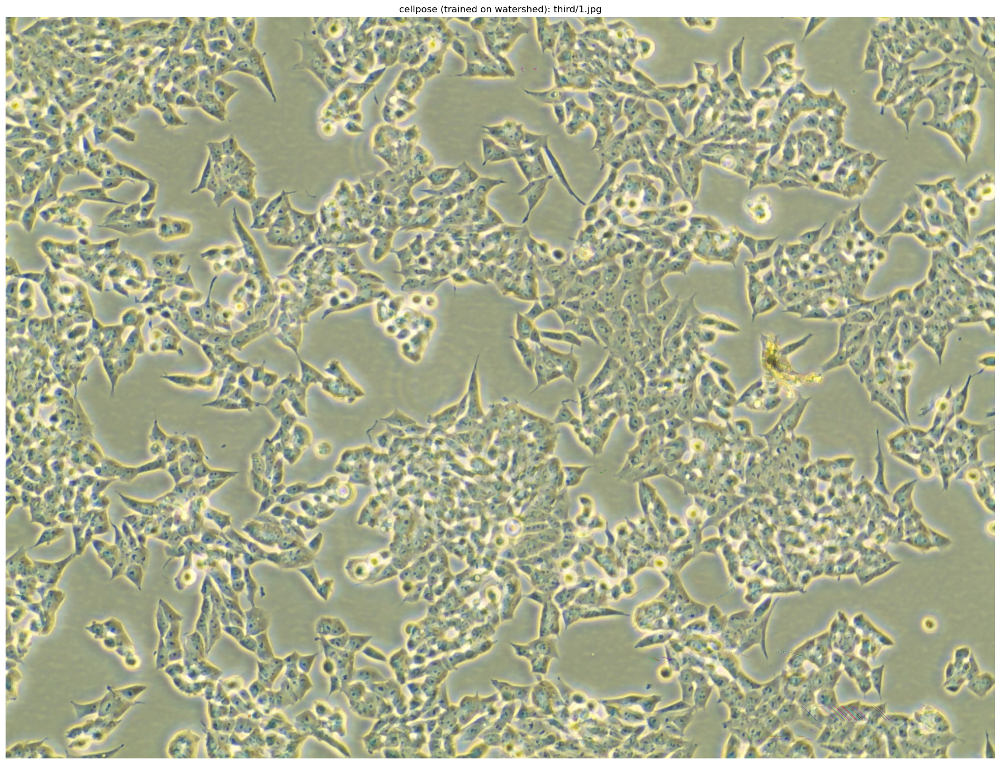

In [7]:

model_train = models.CellposeModel(
    gpu=True, diam_mean=diams[0], net_avg=True, model_type="cyto"
)


plot_image(
    skimage.color.label2rgb(
        masks[0], img, bg_color=None, alpha=0.4, colors=colors, saturation=1
    ),
    title=f"cellpose (vanilla): {img_path}, diameter {diams[0]:.0f}px",
)

model_train.train(
    train_data=images,
    train_labels=[ws],
    channels=[2, 0],
    n_epochs=1,
    #save_path="cyto-1-100",
    learning_rate=0.1,
    weight_decay=0.0001,
)

masks, _flows, _styles = model_train.eval(images, diameter=diams[0], channels=[[2, 0]])

plot_image(
    skimage.color.label2rgb(
        masks[0], img, bg_color=None, alpha=0.4, colors=colors, saturation=1
    ),
    title=f"cellpose (trained on watershed): {img_path}",
)